# Basic code structure

In [ ]:
include("sim/env.jl")

function policy(x,t)
    ifelse(t<2,0.002,0.)
end

x0 = [0, 0, π, 0]
u0 = 0.0
integrator = init_sim(x0,u0;tmax=10.,dt=0.01)
x = x0
u = u0
for (x,t) in tuples(integrator)
    u = policy(x,t)
    x₊ = sim!(integrator,u) # go to next timestep
end


[ Info: Saved animation to /home/julien/lth/proj/group-2/src/anim_pendulum.gif


Plots.AnimatedGif("/home/julien/lth/proj/group-2/src/anim_pendulum.gif")
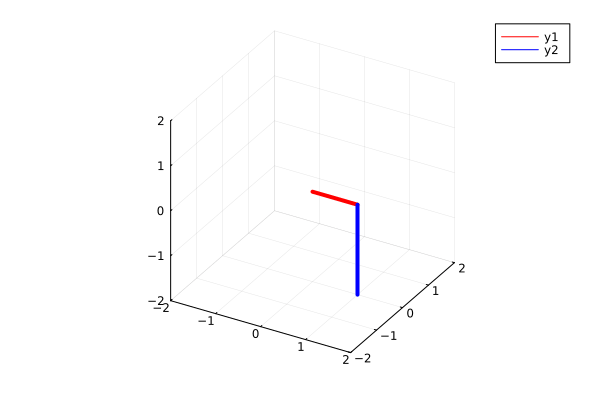

In [ ]:

animate(integrator)


In [5]:
using FurutaPendulums
p=SimulatedFurutaPendulum()
u=[1]
control(p::SimulatedFurutaPendulum, u::AbstractVector)
p.x

4-element Vector{Float64}:
 0.0
 0.0
 3.141592653589793
 0.0

# Implementation details

In [3]:
include("sim/motion.jl")
using LinearAlgebra, Plots, DifferentialEquations

## Euler method
This is not stable, the result changes with different dt 

In [20]:
function control_signal(u, t)
    if t<2
        return u
    else 
        return 0
    end
end

x = [0, 0, 0, 1]
umax = Ku*0.001 

# Plot 1: dt = 1e-3
dt = 1e-3
tmax = 10
n = ceil(Int,tmax/dt)
xs = zeros(4,n+1)
for (i,t) in enumerate(0:dt:tmax)
    u = control_signal(umax, t)
    # dx = nonlinear_frictionfree(x,u)
    dx = nonlinear_friction(x,u)
    x = x + dx*dt
    xs[:,i] = x
end
p1 = plot(0:dt:tmax,xs',label=["ϕ" "dϕ" "θ" "dθ"])

# Plot 2: dt = 5e-5
x = [0, 0, 0, 1]
dt = 5e-5
n = ceil(Int,tmax/dt)
xs = zeros(4,n+1)
for (i,t) in enumerate(0:dt:tmax)
    u = control_signal(umax, t)
    # dx = nonlinear_frictionfree(x,u)
    dx = nonlinear_friction(x,u)
    x = x + dx*dt
    xs[:,i] = x
end
p2 = plot(0:dt:tmax,xs',label=["ϕ" "dϕ" "θ" "dθ"])
plot(p1,p2,layout=(2,1))

## Runge Kutta
This is more stable

In [21]:
function ODEf(du,u,p,t)
    du[:] = nonlinear_friction(u, p[end], p[1:end-1])
end

function policy(x,t)
    u = control_signal(t1,t)
end

u0 = [0, 0, 0, 1]
torque = 0.001
t1 = Ku*torque
p = [α, β, γ, δ, t1]
dt = 0.01
tmin = 0.
tmax = 10.
tspan = (0.,tmax)
prob = ODEProblem(ODEf, u0, tspan, p) #define ODE problem
integrator = init(prob,alg=Tsit5(),tstops=0:dt:10) #init integrator using the Tsitouras solver
us = []
for (u,t) in tuples(integrator)
    x = integrator.u
    u = policy(x,t)
    integrator.p[end] = u
    push!(us,u)
    step!(integrator) # go to next timestep
end

p1 = plot(integrator.sol,label=["ϕ" "dϕ" "θ" "dθ"])

dt = 0.001
prob = ODEProblem(ODEf, u0, tspan, p) #define ODE problem
integrator = init(prob,alg=Tsit5(),tstops=0:dt:10) #init integrator using the Tsitouras solver
us = []
for (u,t) in tuples(integrator)
    x = integrator.u
    u = policy(x,t)
    integrator.p[end] = u
    push!(us,u)
    step!(integrator) # go to next timestep
end

p2 = plot(integrator.sol,label=["ϕ" "dϕ" "θ" "dθ"])
plot(p1,p2,layout=(2,1))